In [ ]:
cv.fillPoly()

In [88]:
mask_path = '/data/colon/IS/S19-19150/patch_100_2_0.5/mask/s2019-19150-a3_he_20210804_171704_1_p3.png'
img_path = '/data/colon/IS/S19-19150/patch_100_2_0.5/image/s2019-19150-a3_he_20210804_171704_1.png'
mask = cv.imread(mask_path,0); img = cv.imread(img_path)

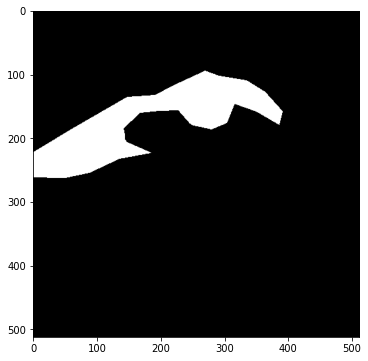

In [75]:
plt.imshow(np.logical_or((mask==2) , (mask==3),))

In [135]:
msk = np.zeros_like(img)

In [136]:
msk[...,0] = mask==0*1
msk[...,1] = mask==1*1
msk[...,2] = np.logical_or(mask==3,mask==2)*1
msk = msk.astype(np.float32)

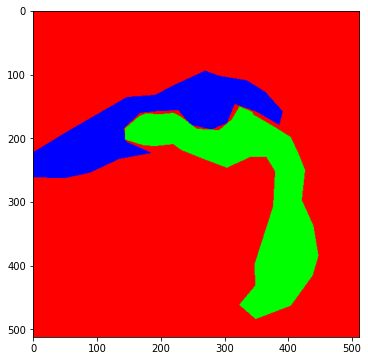

In [137]:
plt.imshow(msk[...],vmin=0,vmax=1)

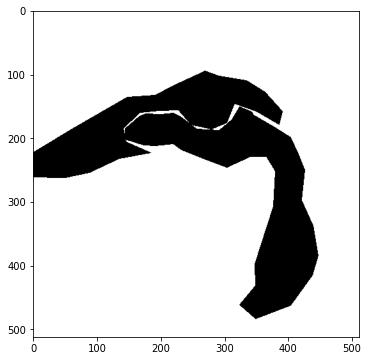

In [89]:
plt.imshow(mask==0)

In [85]:
zero_labels = [1,4]

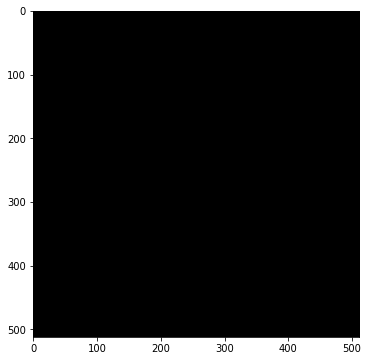

In [86]:
mask2 = mask.copy()
#mask2[mask==1] = 0; mask2[mask==4]=0
for z in zero_labels:
    mask2[mask2==z] = 0
plt.imshow(mask2)

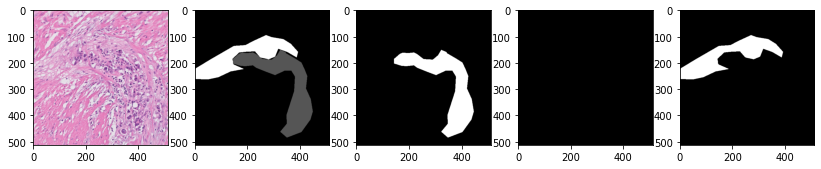

In [56]:
plt.figure(figsize = (14,10))
plt.subplot(1,5,1); plt.imshow(img)
plt.subplot(1,5,2); plt.imshow(mask)
plt.subplot(1,5,3); plt.imshow(mask==1)
plt.subplot(1,5,4); plt.imshow(mask==2)
plt.subplot(1,5,5); plt.imshow(mask==3)

In [48]:
np.unique(mask)

array([0, 1, 2, 3], dtype=uint8)

## 1. Patient level

In [1]:
from cfg import *
import os, glob
from util.processor import slide_processor
import cv2 as cv
import matplotlib.pyplot as plt

In [2]:
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['figure.figsize'] = (8,6)

In [3]:
print(f'데이터 조직 : {ORGAN} 데이터 출처 : {DATA_SOURCE}')
print(f'환자의 수 : {len(ALL_PATIENT_PATHS)}')

데이터 조직 : ['colon'] 데이터 출처 : ['IS']
환자의 수 : 66


환자 level에서는 동일 환자가 multi slide를 갖고 있는 경우가 있어 split을 하지 않고 slide level에서 split을 합니다.<br>
multi slide의 경우 patch dir안에 <b>누적으로 patch를 extract</b> 합니다.<br>
Annotation이 되어 있지 않는 슬라이드의 환자는 따로 분기했지만 annotation slide와 그렇지 않은 slide를 모두 가지고 있는 환자는 분기하지 않았습니다.

In [4]:
for path in ALL_PATIENT_PATHS:
    anno_len = len(glob.glob(path+'*.xml'))
    slide_len = len(glob.glob(path+'*.tiff'))
    if anno_len>=2 and slide_len==anno_len:
        print(f'Multi Slide 환자 : {path} , Slide 갯수 : {slide_len}')
    if anno_len<slide_len:
        print(f'Annotation이 안되어 있는 Slide가 있는 환자 : {path}')
    #else:
        #print(f'단일 Slide 환자 : {path} , Slide 갯수 : {slide_len}')

Multi Slide 환자 : /data/colon/IS/S14-7300/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S17-6609/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S19-12872/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S14-3456/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S17-6850/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S19-17010/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S19-18012/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S19-19150/ , Slide 갯수 : 3
Multi Slide 환자 : /data/colon/IS/S19-17121/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S16-4189/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S14-4626/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S19-11950/ , Slide 갯수 : 2
Multi Slide 환자 : /data/colon/IS/S14-7146/ , Slide 갯수 : 2


## 2. Slide Level

In [5]:
DATA_SPLIT = [0.6,0.2,0.2]
ALL_SLIDE_PATHS = []; [ALL_SLIDE_PATHS.extend(glob.glob(path+'*.tiff')) for path in ALL_PATIENT_PATHS]
TRAIN_SLIDE_PATHS = shuffle(ALL_SLIDE_PATHS,random_state = 311)[:int(DATA_SPLIT[0]*len(ALL_SLIDE_PATHS))]
VALID_SLIDE_PATHS = shuffle(ALL_SLIDE_PATHS,random_state=311)[int(DATA_SPLIT[0]*len(ALL_SLIDE_PATHS)):-int(DATA_SPLIT[2]*len(ALL_SLIDE_PATHS))]
TEST_SLIDE_PATHS = shuffle(ALL_SLIDE_PATHS,random_state=311)[-int(DATA_SPLIT[2]*len(ALL_SLIDE_PATHS)):]

In [6]:
print(f'슬라이드 수 : {len(ALL_SLIDE_PATHS)}')
for slide_path in ALL_SLIDE_PATHS:
    anno_exist = os.path.exists('.'.join(slide_path.split('.')[:-1])+XML_NAME)
    if anno_exist==False:
        print(f'Not Annotation : {slide_path}')
print('')
print('슬라이드의 수는 annotation이 없는 슬라이드를 제외하고 77개입니다. \n Data의 Split은 6:2:2로 나누었습니다.')
print('')
print(f'Train Slide : {len(TRAIN_SLIDE_PATHS)}')
print(f'Valid Slide : {len(VALID_SLIDE_PATHS)}')
print(f'Test Slide  : {len(TEST_SLIDE_PATHS)}')

슬라이드 수 : 77

슬라이드의 수는 annotation이 없는 슬라이드를 제외하고 77개입니다. 
 Data의 Split은 6:2:2로 나누었습니다.

Train Slide : 46
Valid Slide : 16
Test Slide  : 15


### Bounding Box (Region)
Slide가 가지고 있는 Region에 대한 분석입니다.

In [7]:
init_param = {
    'level':LEVEL,
    'overlap':OVERLAP,
    'patch_size':PATCH_SIZE,
    'patch_name':PATCH_NAME
}

In [82]:
slide_path.split('/')[-1].split('.')[0]

'/data/colon/IS/S14-7146/s2014-7146-a5_he_20210804_190433.tiff'

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:38: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


101


"\nif 'p3' in anno_dict['bboxes'].keys():\n    for i, pni_box in enumerate(anno_dict['bboxes']['p3']):\n        cord_box = anno_dict['coords']['p3'][i]\n        cnt = np.reshape(np.array(cord_box),(-1,len(cord_box),2))\n        slide.arr = cv.drawContours(slide.arr,cnt,-1,(0,255,0),1)\n        min_x = np.min(np.array(pni_box)[:,0]); min_y = np.min(np.array(pni_box)[:,1])\n        max_x = np.max(np.array(pni_box)[:,0]); max_y = np.max(np.array(pni_box)[:,1])\n        print(min_x,max_x,min_y,max_y)\n        plt.figure(figsize = (14,10))\n        plt.imshow(slide.arr[min_y:max_y,min_x:max_x])\n"

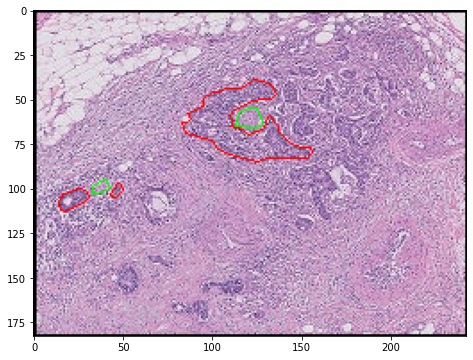

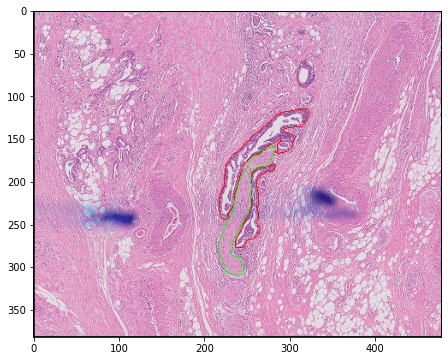

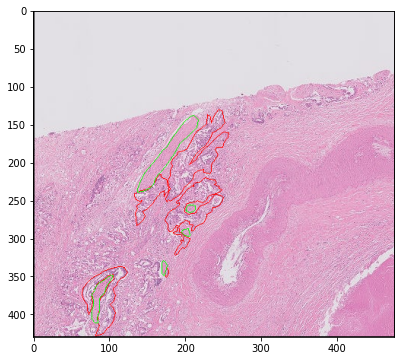

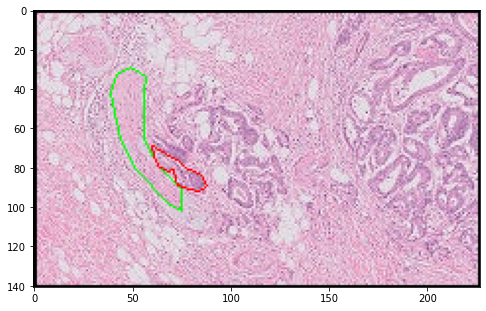

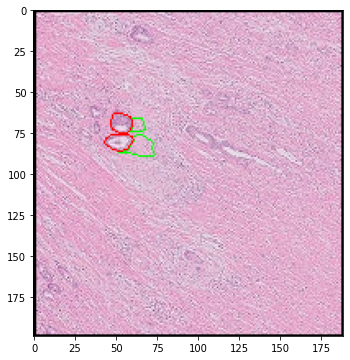

...

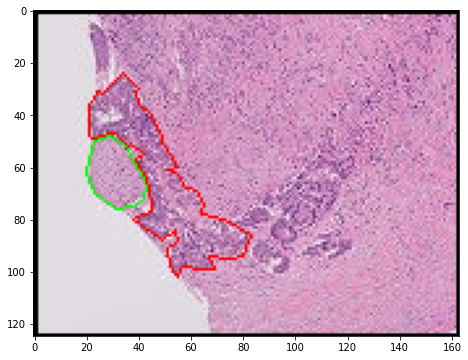

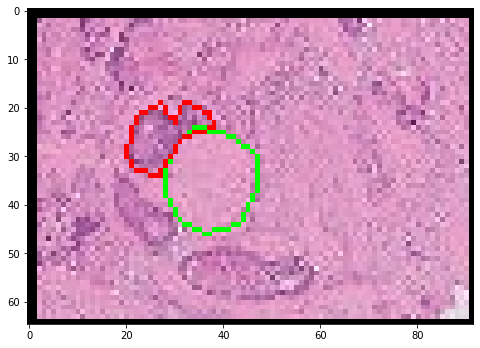

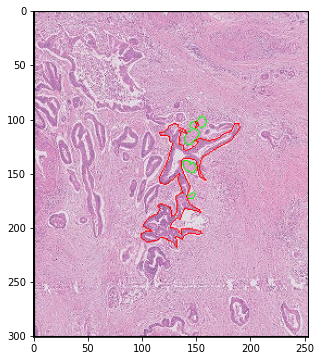

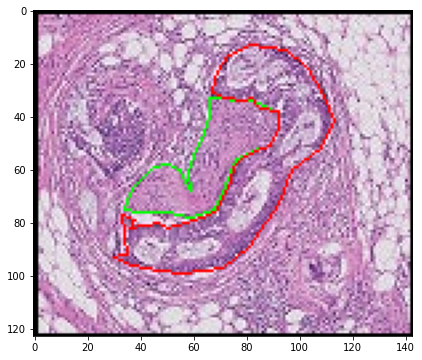

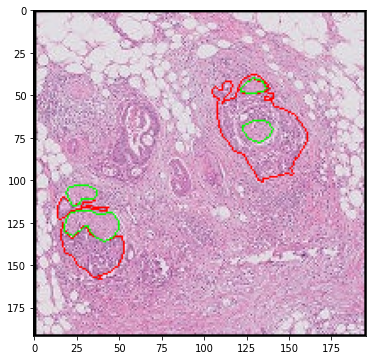

In [85]:
import numpy as np
init_param = {
    'level':LEVEL,
    'overlap':OVERLAP,
    'patch_size':PATCH_SIZE,
    'patch_name':PATCH_NAME
}
count=1
for slide_path in ALL_SLIDE_PATHS[:100]:
    xml_path = '.'.join(slide_path.split('.')[:-1]) + '.xml'
    patient_path = '/'.join(slide_path.split('/')[:-1])
    init_param.update({
        'slide_path':slide_path,
        'xml_path':xml_path
    })
    slide = slide_processor(init_param)
    slide_name = slide_path.split('/')[-1].split('.')[0]
    anno_dict = slide.get_annotation_dict()
    bbox_dict = anno_dict['bboxes']
    coord_dict = anno_dict['coords']
    prt = slide.arr
    for key in coord_dict:
        for i in range(len(coord_dict[key])):
            cnt = np.reshape(np.array(coord_dict[key][i]),(-1,len(coord_dict[key][i]),2))
            if key=='p1':
                prt = cv.drawContours(prt,cnt,-1,(255,0,0),1)
            elif key=='p2':
                prt = cv.drawContours(prt,cnt,-1,(0,0,255),1)
            else:
                prt = cv.drawContours(prt,cnt,-1,(0,255,0),1)
        
    for key in bbox_dict:
        prt = cv.drawContours(prt,np.array(bbox_dict[key]),-1,(0,0,0),2) # draw bbox    
        for i, region in enumerate(bbox_dict[key]):
            min_x, min_y = np.min(region,axis = 0)
            max_x, max_y = np.max(region,axis = 0)
            if key=='p3':
                plt.figure()
                plt.imshow(prt[min_y:max_y,min_x:max_x])
                cv.imwrite(f'/data/colon/IS/all_pnis/{slide_name}_{i}.jpg',prt[min_y:max_y,min_x:max_x])
                count+=1
    
    
print(count)
    
'''
if 'p3' in anno_dict['bboxes'].keys():
    for i, pni_box in enumerate(anno_dict['bboxes']['p3']):
        cord_box = anno_dict['coords']['p3'][i]
        cnt = np.reshape(np.array(cord_box),(-1,len(cord_box),2))
        slide.arr = cv.drawContours(slide.arr,cnt,-1,(0,255,0),1)
        min_x = np.min(np.array(pni_box)[:,0]); min_y = np.min(np.array(pni_box)[:,1])
        max_x = np.max(np.array(pni_box)[:,0]); max_y = np.max(np.array(pni_box)[:,1])
        print(min_x,max_x,min_y,max_y)
        plt.figure(figsize = (14,10))
        plt.imshow(slide.arr[min_y:max_y,min_x:max_x])
'''

In [9]:
p1_bboxes = 0; p2_bboxes = 0; p3_bboxes = 0; p4_bboxes = 0; no_pnis = 0; p3_test_bboxes = 0;
for slide_path in TRAIN_SLIDE_PATHS[:30]:
    xml_path = '.'.join(slide_path.split('.')[:-1]) + '.xml'
    patient_path = '/'.join(slide_path.split('/')[:-1])
    if os.path.exists(xml_path):
        init_param.update({
            'slide_path':slide_path,
            'xml_path':xml_path,
        })
        slide = slide_processor(init_param)
        anno_dict = slide.get_annotation_dict()
        if 'p3' in anno_dict['bboxes'].keys():
            #print(f"pni : {len(anno_dict['bboxes']['p3'])}")
            p3_bboxes += len(anno_dict['bboxes']['p3'])
        elif 'p3_test' in anno_dict['bboxes'].keys():
            print('hi')
            p3_test_bboxes+= len(anno_dict['bboxes']['p3_test'])
        else:
            no_pnis+=1
        
        if 'p4' in anno_dict['bboxes'].keys():
            p4_bboxes += len(anno_dict['bboxes']['p4'])
        
        p1_bboxes += len(anno_dict['bboxes']['p1'])
        p2_bboxes += len(anno_dict['bboxes']['p2'])
    else:
        continue
print('TRAIN_SLIDES')    
print(f'Tumor Regions : {p1_bboxes}\nNerve Regions : {p2_bboxes}\nPNI Regions : {p3_bboxes}\nNormal Region : {p4_bboxes}' )
print(f'NO Pni Region : {no_pnis}')

hi
hi
hi
hi


KeyboardInterrupt: 

In [26]:
p1_bboxes = 0; p2_bboxes = 0; p3_bboxes = 0; p4_bboxes = 0; no_pnis = 0
for slide_path in VALID_SLIDE_PATHS:
    xml_path = '.'.join(slide_path.split('.')[:-1]) + '.xml'
    patient_path = '/'.join(slide_path.split('/')[:-1])
    if os.path.exists(xml_path):
        init_param.update({
            'slide_path':slide_path,
            'xml_path':xml_path,
        })
        slide = slide_processor(init_param)
        anno_dict = slide.get_annotation_dict()
        if 'p3' in anno_dict['bboxes'].keys():
            #print(f"pni : {len(anno_dict['bboxes']['p3'])}")
            p3_bboxes += len(anno_dict['bboxes']['p3'])
        else:
            no_pnis+=1
        if 'p4' in anno_dict['bboxes'].keys():
            p4_bboxes += len(anno_dict['bboxes']['p4'])
        
        p1_bboxes += len(anno_dict['bboxes']['p1'])
        p2_bboxes += len(anno_dict['bboxes']['p2'])
    else:
        continue
print('VALID_SLIDES')    
print(f'Tumor Regions : {p1_bboxes} Nerve Regions : {p2_bboxes} PNI Regions : {p3_bboxes}')
print(f'Tumor Regions : {p1_bboxes}\nNerve Regions : {p2_bboxes}\nPNI Regions : {p3_bboxes}\nNormal Region : {p4_bboxes}' )
print(f'NO Pni Region : {no_pnis}')

VALID_SLIDES
Tumor Regions : 38 Nerve Regions : 42 PNI Regions : 15
Tumor Regions : 38
Nerve Regions : 42
PNI Regions : 15
Normal Region : 0
NO Pni Region : 6


In [27]:
p1_bboxes = 0; p2_bboxes = 0; p3_bboxes = 0; p4_bboxes = 0; no_pnis = 0
for slide_path in TEST_SLIDE_PATHS:
    xml_path = '.'.join(slide_path.split('.')[:-1]) + '.xml'
    patient_path = '/'.join(slide_path.split('/')[:-1])
    if os.path.exists(xml_path):
        init_param.update({
            'slide_path':slide_path,
            'xml_path':xml_path,
        })
        slide = slide_processor(init_param)
        anno_dict = slide.get_annotation_dict()
        if 'p3' in anno_dict['bboxes'].keys():
            #print(f"pni : {len(anno_dict['bboxes']['p3'])}")
            p3_bboxes += len(anno_dict['bboxes']['p3'])
        else:
            no_pnis+=1
        if 'p4' in anno_dict['bboxes'].keys():
            p4_bboxes += len(anno_dict['bboxes']['p4'])
        
        p1_bboxes += len(anno_dict['bboxes']['p1'])
        p2_bboxes += len(anno_dict['bboxes']['p2'])
    else:
        continue
print('TEST_SLIDES')    
print(f'Tumor Regions : {p1_bboxes}\nNerve Regions : {p2_bboxes}\nPNI Regions : {p3_bboxes}\nNormal Region : {p4_bboxes}' )
print(f'NO Pni Region : {no_pnis}')

TEST_SLIDES
Tumor Regions : 46
Nerve Regions : 37
PNI Regions : 23
Normal Region : 4
NO Pni Region : 4


## 3. Patch Level

주어진 Slide들을 학습하여 새로운 Slide를 예측하는 것을 목표로 Split한 Slide를 유지하여 Patch를 추출했습니다.<br>
패치는 100x 패치입니다.

### 1) Nerve

nerve patch는 pni의 nerve와 nerve class 의 nerve를 true class로 잡았습니다.

#### ISH

In [28]:
CLASS_NAME = 'nerve'
if CLASS_NAME=='nerve':
    TRUE_LABEL_LIST = [
        {'label':2,'restrict':0},
        {'label':3,'restrict':0}
    ]
    ZERO_LABEL_LIST = [
        {'label':1,'restrict':10},
        {'label':4,'restrict':20}
    ]
elif CLASS_NAME=='tumor':
    TRUE_LABEL_LIST = [
    {'label':1,'restrict':0}
    ]
    ZERO_LABEL_LIST = [
        {'label':2,'restrict':50},
        {'label':3,'restrict':50},
        {'label':4,'restrict':100}
    ]
else:
    TRUE_LABEL_LIST = [
        {'label':1,'restrict':50},
        {'label':2,'restrict':100},
        {'label':3,'restrict':100},
        {'label':4,'restrict':100}
    ]
    ZERO_LABEL_LIST = []

In [33]:
PATCH_NAME = 'patch_100_4'

In [34]:

TRAIN_ZIP = []
for path in TRAIN_SLIDE_PATHS:
    slide_name = path.split('/')[-1].replace('.tiff','').replace('.svs','')
    patient_path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :
        target_list = glob.glob(patient_path+f'{PATCH_NAME}/mask/{slide_name}*_p{lbl["label"]}.png')
        if lbl['restrict']==0:
            TRAIN_ZIP.extend(target_list) 
        else:
            TRAIN_ZIP.extend(shuffle(target_list,random_state = 311)[:lbl["restrict"]])
    for lbl in ZERO_LABEL_LIST :
        target_list = glob.glob(patient_path+f'{PATCH_NAME}/mask/{slide_name}*_p{lbl["label"]}.png')
        TRAIN_ZIP.extend(shuffle(target_list,random_state = 311)[:lbl["restrict"]])
TRAIN_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TRAIN_ZIP],random_state=311)

VALID_ZIP = []
for path in VALID_SLIDE_PATHS:
    slide_name = path.split('/')[-1].replace('.tiff','').replace('.svs','')
    patient_path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :
        target_list = glob.glob(patient_path+f'{PATCH_NAME}/mask/{slide_name}*_p{lbl["label"]}.png')
        VALID_ZIP.extend(target_list) 
    for lbl in ZERO_LABEL_LIST :
        target_list = glob.glob(patient_path+f'{PATCH_NAME}/mask/{slide_name}*_p{lbl["label"]}.png')
        VALID_ZIP.extend(shuffle(target_list,random_state = 311)[:lbl["restrict"]])
VALID_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in VALID_ZIP],random_state=311)

TEST_ZIP = []
for path in TEST_SLIDE_PATHS:
    slide_name = path.split('/')[-1].replace('.tiff','').replace('.svs','')
    patient_path = '/'.join(path.split('/')[:-1]) + '/'
    
    for lbl in TRUE_LABEL_LIST :
        target_list = glob.glob(patient_path+f'{PATCH_NAME}/mask/{slide_name}*_p{lbl["label"]}.png')
        TEST_ZIP.extend(target_list) 
    
    for lbl in ZERO_LABEL_LIST :
        target_list = glob.glob(patient_path+f'{PATCH_NAME}/mask/{slide_name}*_p{lbl["label"]}.png')
        TEST_ZIP.extend(shuffle(target_list,random_state = 311)[:lbl["restrict"]])
        
TEST_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TEST_ZIP],random_state=311)

In [35]:
tr_1 = 0; tr_2 = 0; tr_3 = 0 ; tr_4 = 0
vl_1 = 0; vl_2 = 0; vl_3 = 0 ; vl_4 = 0
te_1 = 0; te_2 = 0; te_3 = 0 ; te_4 = 0

for tup in TRAIN_ZIP:
    x = tup[-1][-5]
    if x=='1':
        tr_1+=1
    elif x=='2':
        tr_2+=1
    elif x=='3':
        tr_3+=1
    else:
        tr_4+=1
print(f'TRAIN PATCH CLASS\nNERVE : {tr_2 + tr_3} NOT_NERVE : {tr_1+tr_4} (TUMOR : {tr_1} NORMAL : {tr_4})')
for tup in VALID_ZIP:
    x = tup[-1][-5]
    if x=='1':
        vl_1+=1
    elif x=='2':
        vl_2+=1
    elif x=='3':
        vl_3+=1
    else:
        vl_4+=1
print(f'VALID PATCH CLASS\nNERVE : {vl_2 + vl_3} NOT_NERVE : {vl_1+vl_4} (TUMOR : {vl_1} NORMAL : {vl_4})')
for tup in TEST_ZIP:
    x = tup[-1][-5]
    if x=='1':
        te_1+=1
    elif x=='2':
        te_2+=1
    elif x=='3':
        te_3+=1
    else:
        te_4+=1
print(f'TEST PATCH CLASS\nNERVE : {te_2 + te_3} NOT_NERVE : {te_1+te_4} (TUMOR : {te_1} NORMAL : {te_4})')

TRAIN PATCH CLASS
NERVE : 152 NOT_NERVE : 455 (TUMOR : 455 NORMAL : 0)
VALID PATCH CLASS
NERVE : 43 NOT_NERVE : 170 (TUMOR : 170 NORMAL : 0)
TEST PATCH CLASS
NERVE : 57 NOT_NERVE : 132 (TUMOR : 132 NORMAL : 0)


In [36]:
print(f'Nerve 패치 총 갯수 : {len(TRAIN_ZIP) + len(VALID_ZIP) + len(TEST_ZIP)}')
print(f'Train Length : {len(TRAIN_ZIP)} Valid Length : {len(VALID_ZIP)} Test Length : {len(TEST_ZIP)}')

Nerve 패치 총 갯수 : 1009
Train Length : 607 Valid Length : 213 Test Length : 189


## Tumor

In [33]:
CLASS_NAME = 'tumor'
PATCH_NAME = 'patch_100_5'
if CLASS_NAME=='nerve':
    TRUE_LABEL_LIST = [
        {'label':2,'restrict':0},
        {'label':3,'restrict':0}
    ]
    ZERO_LABEL_LIST = [
        {'label':1,'restrict':10},
        {'label':4,'restrict':20}
    ]
elif CLASS_NAME=='tumor':
    TRUE_LABEL_LIST = [
    {'label':1,'restrict':0}
    ]
    ZERO_LABEL_LIST = [
        {'label':2,'restrict':50},
        {'label':3,'restrict':50},
        {'label':4,'restrict':100}
    ]
else:
    TRUE_LABEL_LIST = [
        {'label':1,'restrict':50},
        {'label':2,'restrict':100},
        {'label':3,'restrict':100},
        {'label':4,'restrict':100}
    ]
    ZERO_LABEL_LIST = []
TRAIN_ZIP = []
for path in TRAIN_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :TRAIN_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :TRAIN_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])

TRAIN_ZIP = []        

for path in TRAIN_SLIDE_PATHS:
    slide_name = path.split('/')[-1].replace('.tiff','').replace('svs','')
    patient_path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :
        target_list = glob.glob(patient_path+f'{PATCH_NAME}/mask/{slide_name}*_p{lbl["label"]}.png')
        #print(len(target_list))
        if lbl['restrict']==0:
            TRAIN_ZIP.extend(target_list)
        else:
            TRAIN_ZIP.extend(shuffle(target_list,random_state = 311)[:lbl["restrict"]])
    for lbl in ZERO_LABEL_LIST :
        target_list = glob.glob(patient_path+f'{PATCH_NAME}/mask/{slide_name}*_p{lbl["label"]}.png')
        TRAIN_ZIP.extend(shuffle(target_list,random_state = 311)[:lbl["restrict"]])
        
TRAIN_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TRAIN_ZIP],random_state=311)
VALID_ZIP = []
for path in VALID_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :VALID_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :VALID_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
VALID_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in VALID_ZIP],random_state=311)
TEST_ZIP = []
for path in TEST_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :TEST_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :TEST_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
TEST_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TEST_ZIP],random_state=311)

print(f'Tumor 패치 총 갯수 : {len(TRAIN_ZIP) + len(VALID_ZIP) + len(TEST_ZIP)}')
print(f'Train Length : {len(TRAIN_ZIP)} Valid Length : {len(VALID_ZIP)} Test Length : {len(TEST_ZIP)}')

tr_1 = 0; tr_2 = 0; tr_3 = 0 ; tr_4 = 0
vl_1 = 0; vl_2 = 0; vl_3 = 0 ; vl_4 = 0
te_1 = 0; te_2 = 0; te_3 = 0 ; te_4 = 0

for tup in TRAIN_ZIP:
    x = tup[-1][-5]
    if x=='1':
        tr_1+=1
    elif x=='2':
        tr_2+=1
    elif x=='3':
        tr_3+=1
    else:
        tr_4+=1
print(f'TRAIN PATCH CLASS\nTUMOR : {tr_1 } NOT_TUMOR : {tr_3+tr_4+tr_2} (NERVE : {tr_2+tr_3} NORMAL : {tr_4})')
for tup in VALID_ZIP:
    x = tup[-1][-5]
    if x=='1':
        vl_1+=1
    elif x=='2':
        vl_2+=1
    elif x=='3':
        vl_3+=1
    else:
        vl_4+=1
print(f'VALID PATCH CLASS\nTUMOR : {vl_1 } NOT_TUMOR : {vl_2+vl_4+ vl_3} (NERVE : {vl_2+vl_3} NORMAL : {vl_4})')
for tup in TEST_ZIP:
    x = tup[-1][-5]
    if x=='1':
        te_1+=1
    elif x=='2':
        te_2+=1
    elif x=='3':
        te_3+=1
    else:
        te_4+=1
print(f'TEST PATCH CLASS\nTUMOR : {te_1 } NOT_TUMOR : {te_2+te_4+ te_3} (NERVE : {te_2+te_3} NORMAL : {te_4})')

Tumor 패치 총 갯수 : 13233
Train Length : 7553 Valid Length : 2474 Test Length : 3206
TRAIN PATCH CLASS
TUMOR : 6485 NOT_TUMOR : 1068 (NERVE : 608 NORMAL : 460)
VALID PATCH CLASS
TUMOR : 2218 NOT_TUMOR : 256 (NERVE : 256 NORMAL : 0)
TEST PATCH CLASS
TUMOR : 2702 NOT_TUMOR : 504 (NERVE : 404 NORMAL : 100)


#### PAIP

In [19]:
PAIP_PATCH_NAME = 'patches'
PAIP_TRUE_LABEL_LIST = [
    {'label':2,'restrict':0},
    {'label':3,'restrict':0}
]
PAIP_ZERO_LABEL_LIST = [
    {'label':3,'restrict':30},
    {'label':4,'restrict':5}
]


PAIP_ALL_SLIDE_PATHS = []; [PAIP_ALL_SLIDE_PATHS.extend(glob.glob(path+'*.svs')) for path in ALL_PATIENT_PATHS]
PAIP_TRAIN_SLIDE_PATHS = shuffle(PAIP_ALL_SLIDE_PATHS,random_state = 311)[:int(DATA_SPLIT[0]*len(PAIP_ALL_SLIDE_PATHS))]
PAIP_VALID_SLIDE_PATHS = shuffle(PAIP_ALL_SLIDE_PATHS,random_state=311)[int(DATA_SPLIT[0]*len(PAIP_ALL_SLIDE_PATHS)):-int(DATA_SPLIT[2]*len(PAIP_ALL_SLIDE_PATHS))]
PAIP_TEST_SLIDE_PATHS = shuffle(PAIP_ALL_SLIDE_PATHS,random_state=311)[-int(DATA_SPLIT[2]*len(PAIP_ALL_SLIDE_PATHS)):]

PAIP_TRAIN_ZIP = []
for path in PAIP_TRAIN_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in PAIP_TRUE_LABEL_LIST :PAIP_TRAIN_ZIP.extend(glob.glob(path+f'{PAIP_PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in PAIP_ZERO_LABEL_LIST :PAIP_TRAIN_ZIP.extend(glob.glob(path+f'{PAIP_PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
PAIP_TRAIN_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in PAIP_TRAIN_ZIP],random_state=311)
PAIP_VALID_ZIP = []
for path in PAIP_VALID_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in PAIP_TRUE_LABEL_LIST :PAIP_VALID_ZIP.extend(glob.glob(path+f'{PAIP_PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in PAIP_ZERO_LABEL_LIST :PAIP_VALID_ZIP.extend(glob.glob(path+f'{PAIP_PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
PAIP_VALID_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in PAIP_VALID_ZIP],random_state=311)
PAIP_TEST_ZIP = []
for path in PAIP_TEST_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in PAIP_TRUE_LABEL_LIST :PAIP_TEST_ZIP.extend(glob.glob(path+f'{PAIP_PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in PAIP_ZERO_LABEL_LIST :PAIP_TEST_ZIP.extend(glob.glob(path+f'{PAIP_PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
PAIP_TEST_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in PAIP_TEST_ZIP],random_state=311)

In [20]:
print(f'Nerve 패치 총 갯수 : {len(PAIP_TRAIN_ZIP) + len(PAIP_VALID_ZIP) + len(PAIP_TEST_ZIP)}')
print(f'Train Length : {len(PAIP_TRAIN_ZIP)} Valid Length : {len(PAIP_VALID_ZIP)} Test Length : {len(PAIP_TEST_ZIP)}')

Nerve 패치 총 갯수 : 11428
Train Length : 7785 Valid Length : 1886 Test Length : 1757


#### Visualize Patch

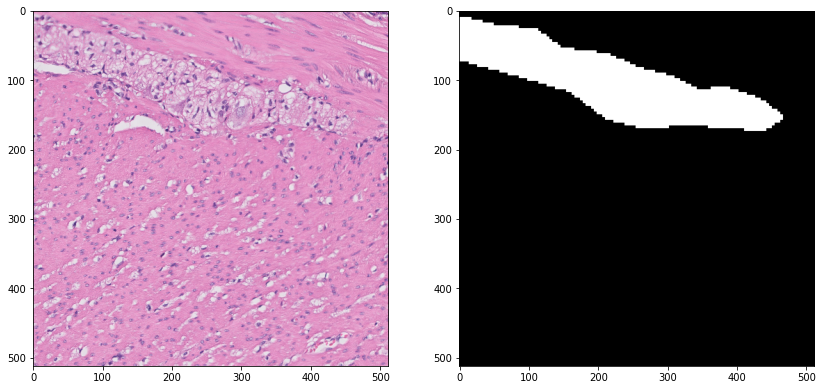

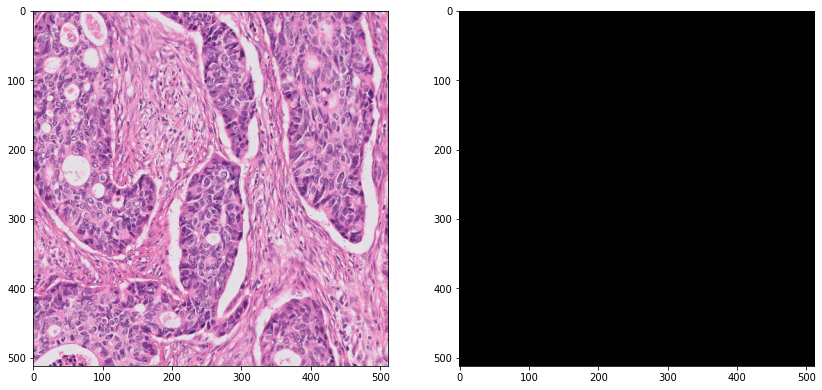

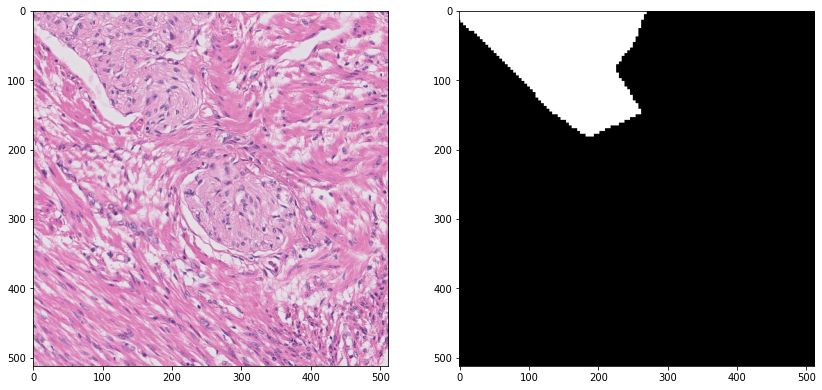

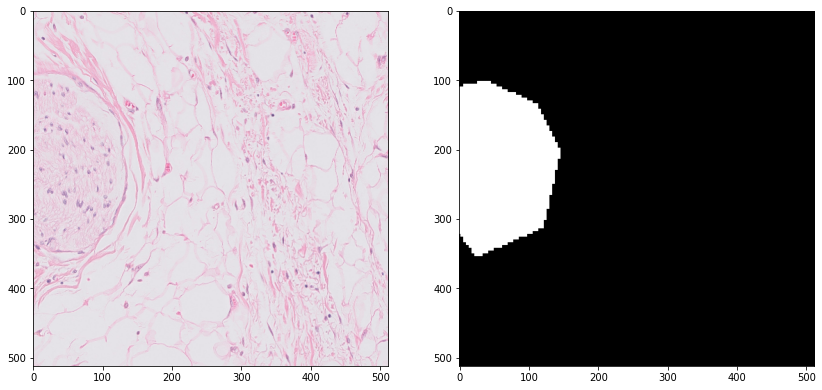

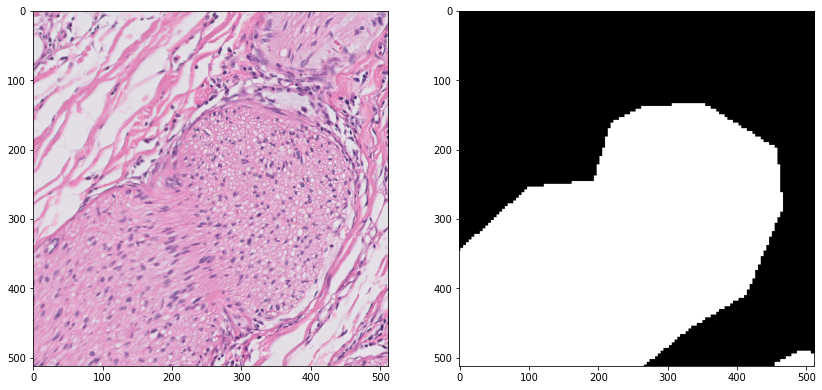

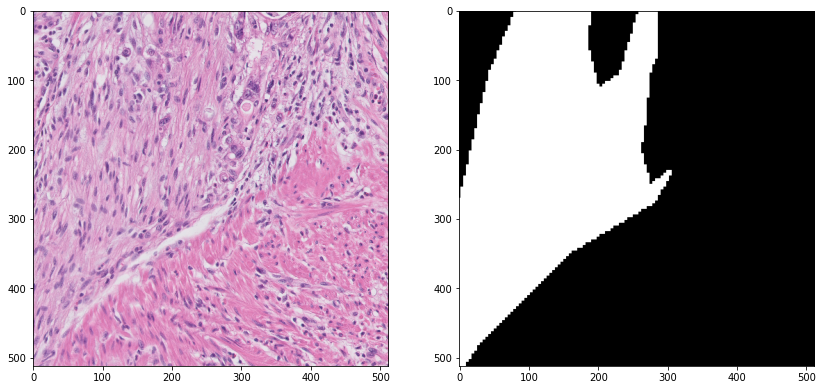

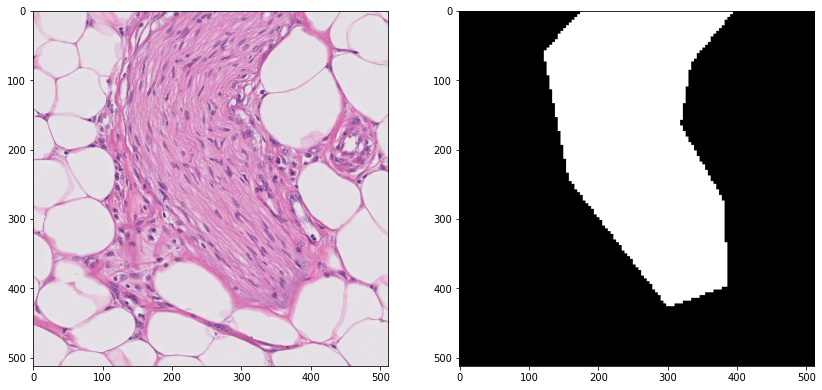

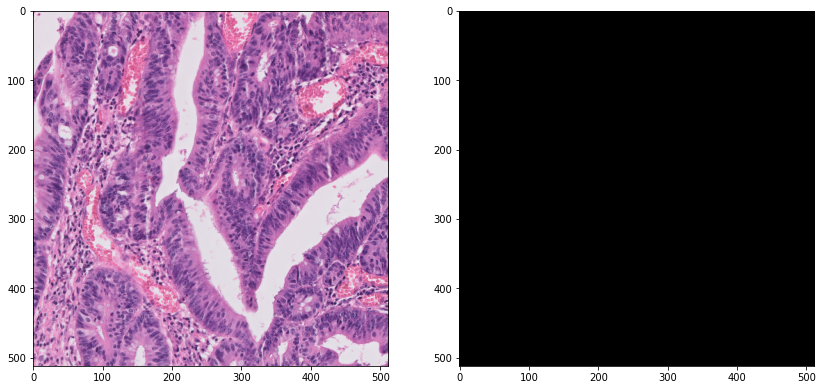

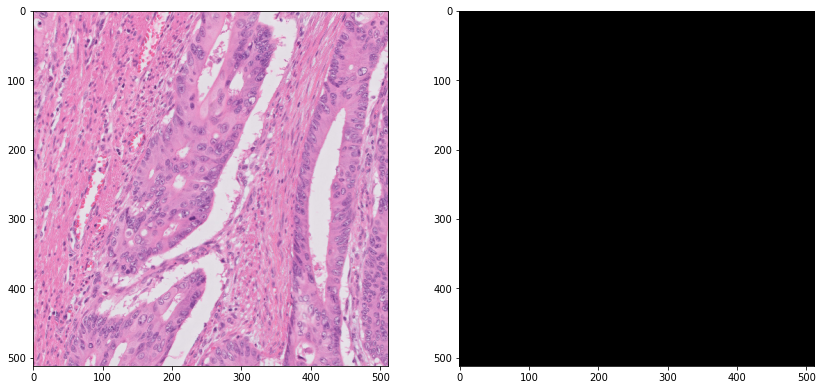

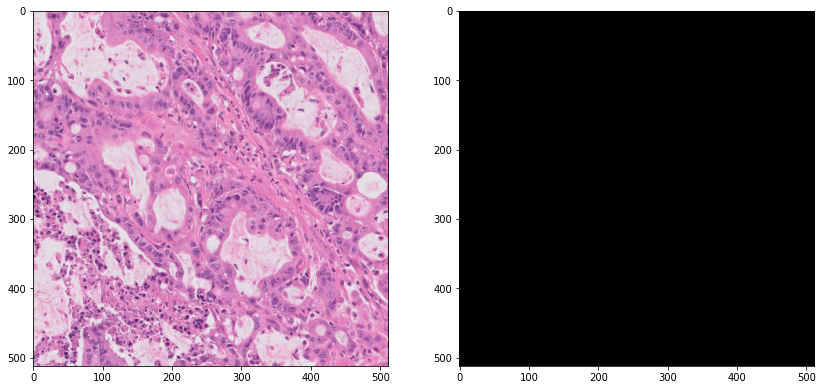

In [78]:
import numpy as np
for img_path,mask_path in TRAIN_ZIP[:10]:
    img = cv.imread(img_path); mask = cv.imread(mask_path,0)
    plt.figure(figsize = (14,10))
    plt.subplot(1,2,1); plt.imshow(img)
    if mask_path[-5]=='1' or mask_path[-5]=='4':
        plt.subplot(1,2,2); plt.imshow(np.zeros_like(img),vmin=0,vmax=1)
    else:
        plt.subplot(1,2,2); plt.imshow(mask,vmin=0,vmax=1)

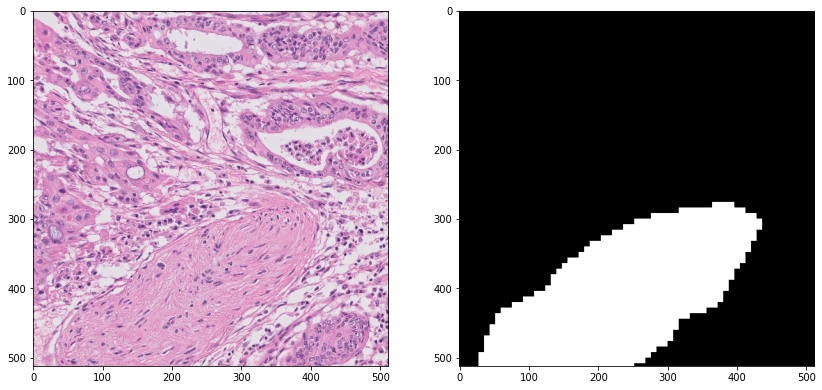

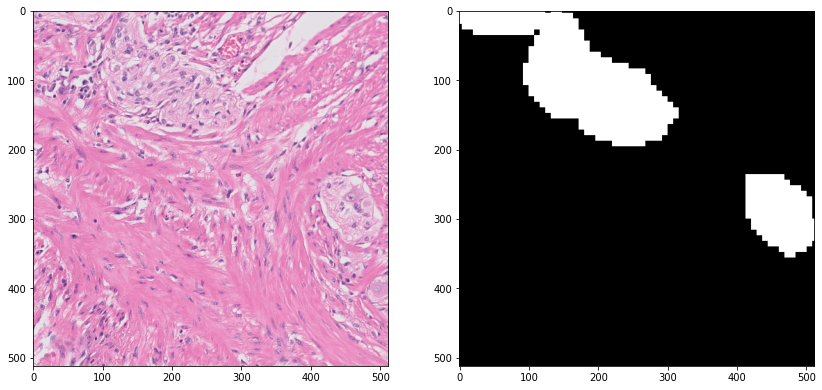

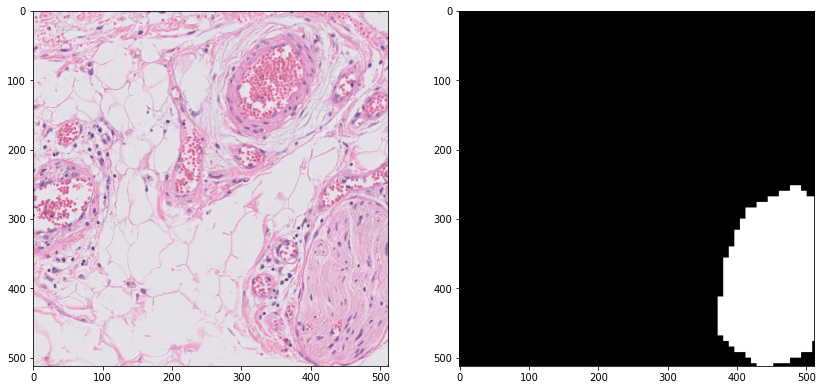

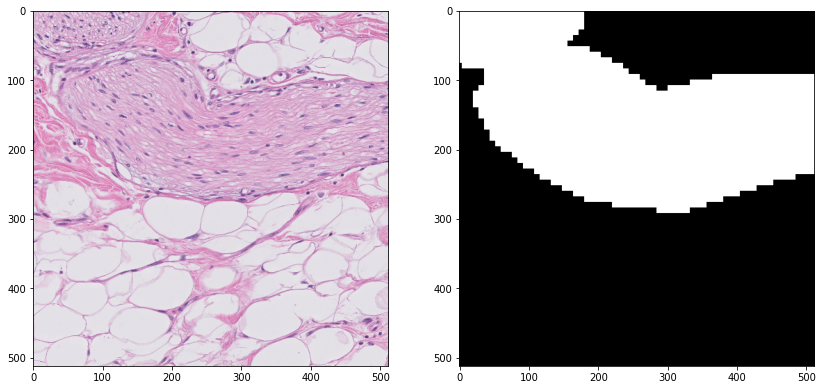

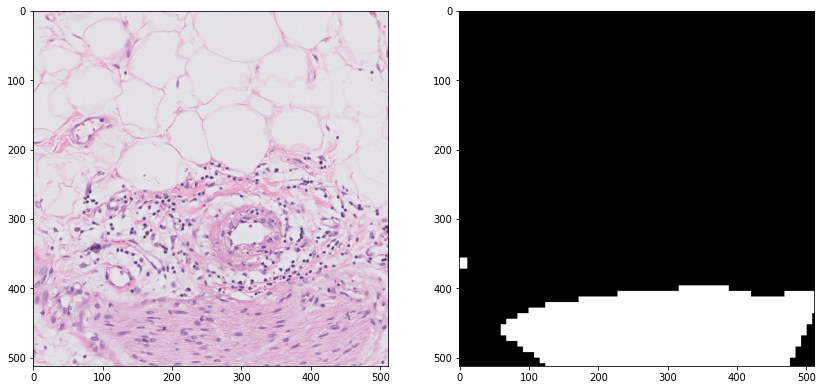

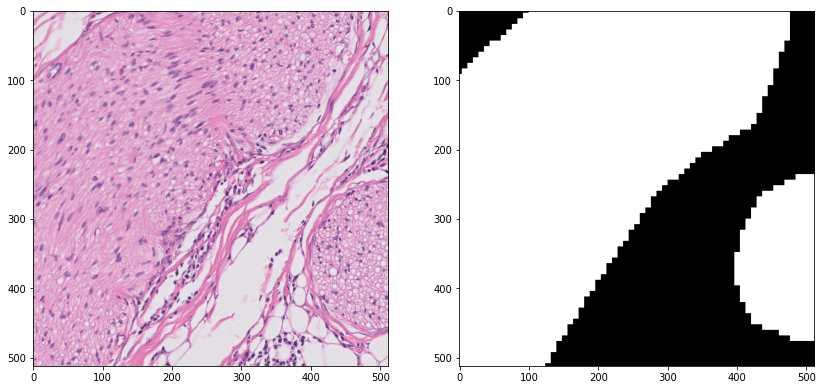

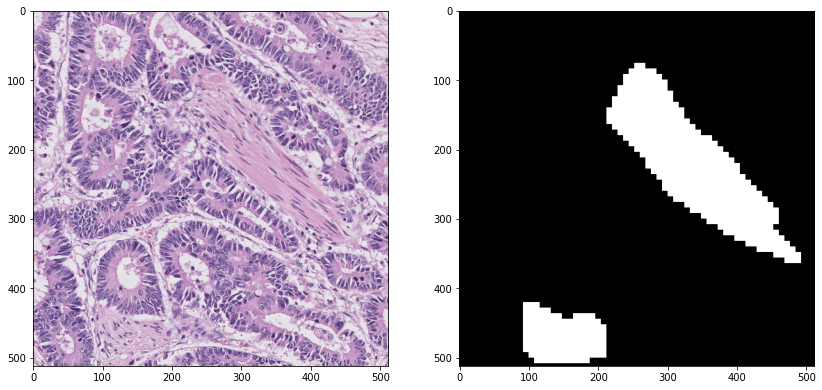

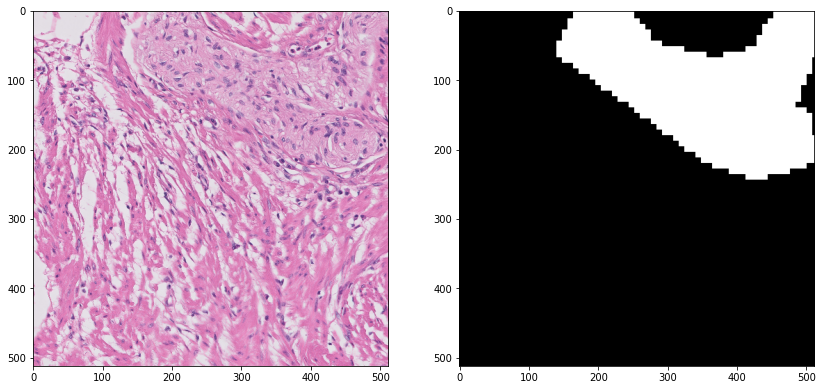

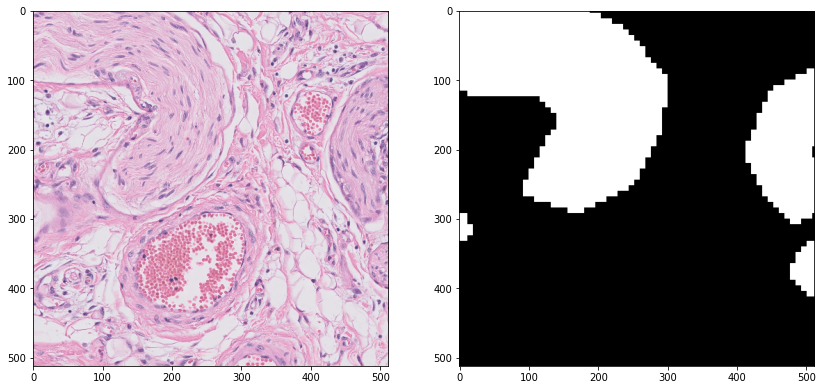

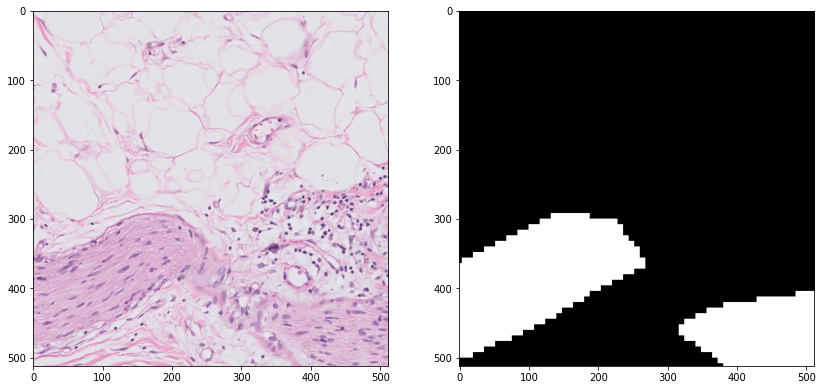

In [68]:
color = ('r','g','b')
for img_path,mask_path in TRAIN_ZIP[:10]:
    img = cv.imread(img_path); mask = cv.imread(mask_path,0)
    plt.figure(figsize = (14,10))
    plt.subplot(1,2,1); plt.imshow(img)
    plt.subplot(1,2,2); plt.imshow(mask)
    

In [ ]:
import numpy as np
nb_bins = 256
count_r = np.zeros(nb_bins)
count_g = np.zeros(nb_bins)
count_b = np.zeros(nb_bins)

for image_path,_ in TRAIN_ZIP[:30]:    
    x = cv.imread(image_path)
    x = x.transpose(2,0,1)
    hist_r = np.histogram(x[0], bins=nb_bins, range=[0, 255])
    hist_g = np.histogram(x[1], bins=nb_bins, range=[0, 255])
    hist_b = np.histogram(x[2], bins=nb_bins, range=[0, 255])
    count_r += hist_r[0]
    count_g += hist_g[0]
    count_b += hist_b[0]

bins = hist_r[1]
fig = plt.figure(figsize = (16,12))
plt.subplot(3,1,1)
#plt.hist(count_r, bins=30, color='r', alpha=0.33)
plt.bar(bins[:-1], count_r, color='r', alpha=0.33)
plt.subplot(3,1,2)
plt.bar(bins[:-1], count_g, color='g', alpha=0.33)
plt.subplot(3,1,3)
plt.bar(bins[:-1], count_b, color='b', alpha=0.33)

In [ ]:
## ISH NERVE
TRUE_LABEL_LIST = [
    {'label':2,'restrict':0},
    {'label':3,'restrict':0}
]
ZERO_LABEL_LIST = []
TRAIN_ZIP = []
for path in TRAIN_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :TRAIN_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :TRAIN_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
TRAIN_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TRAIN_ZIP],random_state=311)
VALID_ZIP = []
for path in VALID_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :VALID_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :VALID_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
VALID_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in VALID_ZIP],random_state=311)
TEST_ZIP = []
for path in TEST_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :TEST_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :TEST_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
TEST_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TEST_ZIP],random_state=311)

In [ ]:
## PAIP NERVE
paip_slide_paths = []; [paip_slide_paths.extend(glob.glob(path+'*.svs')) for path in ALL_PATIENT_PATHS]
TRAIN_SLIDE_PATHS = shuffle(ALL_SLIDE_PATHS,random_state = 311)[:int(DATA_SPLIT[0]*len(ALL_SLIDE_PATHS))]
VALID_SLIDE_PATHS = shuffle(ALL_SLIDE_PATHS,random_state=311)[int(DATA_SPLIT[0]*len(ALL_SLIDE_PATHS)):-int(DATA_SPLIT[2]*len(ALL_SLIDE_PATHS))]
TEST_SLIDE_PATHS = shuffle(ALL_SLIDE_PATHS,random_state=311)[-int(DATA_SPLIT[2]*len(ALL_SLIDE_PATHS)):]

TRUE_LABEL_LIST = [
    {'label':2,'restrict':0},
    {'label':3,'restrict':0}
]
ZERO_LABEL_LIST = []
TRAIN_PAIP_ZIP = []
for path in TRAIN_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :TRAIN_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :TRAIN_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
TRAIN_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TRAIN_ZIP],random_state=311)
VALID_ZIP = []
for path in VALID_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :VALID_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :VALID_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
VALID_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in VALID_ZIP],random_state=311)
TEST_ZIP = []
for path in TEST_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :TEST_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :TEST_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
TEST_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TEST_ZIP],random_state=311)

In [54]:
samples = 500
ish_hist_r = 0; ish_hist_g = 0; ish_hist_b = 0
paip_hist_r = 0; paip_hist_g = 0; paip_hist_b = 0
for i in range(samples):
    ish_img_path , _  = TRAIN_ZIP[i]
    paip_img_path, _  = PAIP_TRAIN_ZIP[i]
    ish_img = cv.imread(ish_img_path)
    paip_img = cv.imread(paip_img_path)
    ish_r = cv.calcHist([ish_img],[0],None,[256],[0,256])
    ish_g = cv.calcHist([ish_img],[1],None,[256],[0,256])
    ish_b = cv.calcHist([ish_img],[2],None,[256],[0,256])
    paip_r = cv.calcHist([paip_img],[0],None,[256],[0,256])
    paip_g = cv.calcHist([paip_img],[1],None,[256],[0,256])
    paip_b = cv.calcHist([paip_img],[2],None,[256],[0,256])
    ish_hist_r += ish_r
    ish_hist_g += ish_g
    ish_hist_b += ish_b
    paip_hist_r += paip_r
    paip_hist_g += paip_g
    paip_hist_b += paip_b
    
ish_hist_r/=samples
ish_hist_g/=samples
ish_hist_b/=samples
paip_hist_r/=samples
paip_hist_g/=samples
paip_hist_b/=samples

    

Text(0.5, 0.98, 'RGB in NERVE : 500')

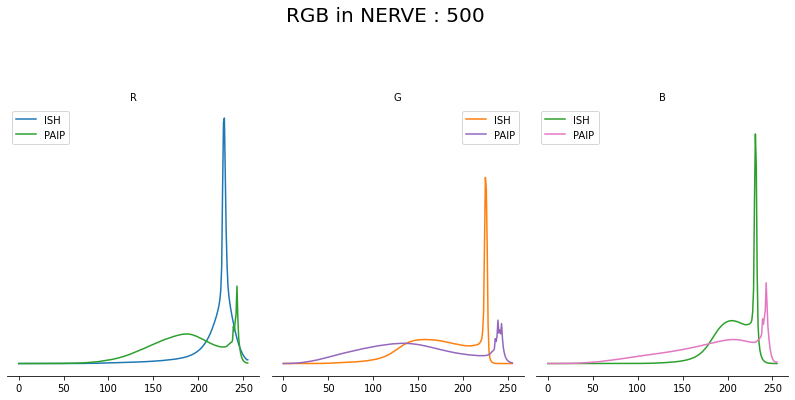

In [71]:
fig,axes = plt.subplots(ncols=3, nrows=1, figsize=(14,6), # 행 수, 열 수 지정, 크기 지정
                         gridspec_kw={"wspace":0.05, "hspace":0.1}, # subplots 사이 간격 지정
                         sharex=True, sharey=True)

colors = ['R','G','B']
hist_ish = [ish_hist_r,ish_hist_g,ish_hist_b]
hist_paip = [paip_hist_r,paip_hist_g,paip_hist_b]
axes = axes.ravel()

for i,(ax,hist) in enumerate(zip(axes,hist_ish)) :
    ax.spines["left"].set_visible(False)
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    ax.plot(hist,color = f'C{i}',label = 'ISH')
    ax.plot(hist_paip[i],color = f'C{2*(i+1)}',label = 'PAIP')
    ax.set_yticks([])
    ax.set_title(colors[i],fontsize = 10)
    ax.legend()
    

fig.subplots_adjust(top=0.75)
fig.suptitle(f'RGB in NERVE : {samples}',fontsize = 20)


### 2) Tumor

In [ ]:
import numpy as np
for img_path,mask_path in TRAIN_ZIP[:10]:
    img = cv.imread(img_path); mask = cv.imread(mask_path,0)
    plt.figure(figsize = (14,10))
    plt.subplot(1,2,1); plt.imshow(img)
    if mask_path[-5]=='1' or mask_path[-5]=='4':
        plt.subplot(1,2,2); plt.imshow(np.zeros_like(img),vmin=0,vmax=1)
    else:
        plt.subplot(1,2,2); plt.imshow(mask,vmin=0,vmax=1)

In [ ]:
for img_path,mask_path in TRAIN_ZIP[:10]:
    img = cv.imread(img_path); mask = cv.imread(mask_path,0)
    plt.figure(figsize = (14,10))
    plt.subplot(1,2,1); plt.imshow(img)
    plt.subplot(1,2,2); plt.imshow(mask,vmin=0,vmax=1)

Tumor의 경우 Annotation이 영역에 대한 Annotation의 경향이 있어 magnification을 50x로 하여 fov를 넓혀서 확인할 예정입니다.

### 50x

In [ ]:
TRUE_LABEL_LIST = [
    {'label':1,'restrict':0}, # tumor
]
PATCH_NAME='patch50'
TRAIN_ZIP = []
for path in TRAIN_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :TRAIN_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :TRAIN_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
TRAIN_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TRAIN_ZIP],random_state=311)
VALID_ZIP = []
for path in VALID_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :VALID_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :VALID_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
VALID_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in VALID_ZIP],random_state=311)
TEST_ZIP = []
for path in TEST_SLIDE_PATHS:
    path = '/'.join(path.split('/')[:-1]) + '/'
    for lbl in TRUE_LABEL_LIST :TEST_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')) 
    for lbl in ZERO_LABEL_LIST :TEST_ZIP.extend(glob.glob(path+f'{PATCH_NAME}/mask/*_p{lbl["label"]}.png')[:lbl["restrict"]])
TEST_ZIP = shuffle([('/'.join(x.split('/')[:-2])+'/image/'+re.sub('_p[0-9]','',x.split('/')[-1]),x) for x in TEST_ZIP],random_state=311)

In [ ]:
for img_path,mask_path in TRAIN_ZIP[:10]:
    img = cv.imread(img_path); mask = cv.imread(mask_path,0)
    plt.figure(figsize = (14,10))
    plt.subplot(1,2,1); plt.imshow(img)
    plt.subplot(1,2,2); plt.imshow(mask,vmin=0,vmax=1)